In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.figure_factory as ff
import plot_utils

df = pd.read_pickle('data/pickle/final_dataset.pk1')

In [2]:
# https://colorbrewer2.org/#type=diverging&scheme=RdGy&n=10
DIVERGENT_RGB = ['rgb(66,146,198)', 'rgb(107,174,214)',
                 'rgb(158,202,225)', 'rgb(254,230,206)',
                 'rgb(253,208,162)', 'rgb(253,174,107)',
                 'rgb(253,141,60)', 'rgb(241,105,19)',
                 'rgb(217,72,1)', 'rgb(166,54,3)',
                 'rgb(127,39,4)']

DECILE_RGB = ['rgb(251,253,248)','rgb(247,252,240)','rgb(224,243,219)',
                'rgb(204,235,197)','rgb(168,221,181)',
                'rgb(123,204,196)','rgb(78,179,211)',
                'rgb(43,140,190)','rgb(8,104,172)',
                'rgb(8,64,129)', 'rgb(5,41,82)',
                'rgb(0,0,0)', 'rgb(0,0,0)']

QUARTILE_RGB = ['rgb(168,221,181)','rgb(123,204,196)',
                'rgb(78,179,211)','rgb(43,140,190)',
                'rgb(8,104,172)','rgb(8,64,129)',
                'rgb(5,41,82)','rgb(0,0,0)']

def map_by_county(att, bins, df=df, title=None, colorscale=DECILE_RGB):
    values = df[att].tolist()
    fips = df['FIPS'].tolist()   
    
    if not title:
        title = att + " by County"

    fig = ff.create_choropleth(
        fips=fips, values=values, binning_endpoints=bins, colorscale=colorscale,
        county_outline={'color': 'rgb(255,255,255)', 'width': 0.5},
        legend_title=att, title=title
    )
    
    fig.layout.template = None
    
    return fig

# Unemployment #

In [3]:
# Use deciles from April 2020 as bins for all employment data for consistency (Change to April)
unemp_bins = list(pd.qcut(df['Apr-20'],10, retbins=True)[-1])
map_by_county('Apr-20', unemp_bins, title="April 2020 Unemployment by County")

In [4]:
# Comparison Data
map_by_county('Feb-20', unemp_bins, title="Februrary 2020 Unemployment by County")

In [5]:
# Comparison data
map_by_county('Apr-19', unemp_bins, title="April 2019 Unemployment by County")

<function matplotlib.pyplot.show(*args, **kw)>

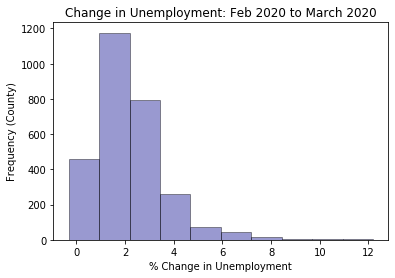

In [6]:
sns.distplot(df['monthly_change'], hist=True, kde=False, 
             bins=10, color = 'darkblue', 
              hist_kws={'edgecolor':'black'},
              kde_kws={'linewidth': 4})
plt.xlabel('% Change in Unemployment')
plt.ylabel('Frequency (County)')
plt.title('Change in Unemployment: Feb 2020 to March 2020')
plt.show

In [7]:
df['monthly_change'].describe()

count    2826.000000
mean        2.192739
std         1.410072
min        -0.311111
25%         1.212282
50%         1.936835
75%         2.827211
max        12.187500
Name: monthly_change, dtype: float64

In [8]:
unemp_change_bins = [-0.5, -.25, 0, .25, .5, .75, 1., 1.25, 1.5]

In [9]:
map_by_county('monthly_change', unemp_change_bins,
                title="Change in Unemployment: Feb 2020 to April 2020",
                colorscale=DIVERGENT_RGB)

<function matplotlib.pyplot.show(*args, **kw)>

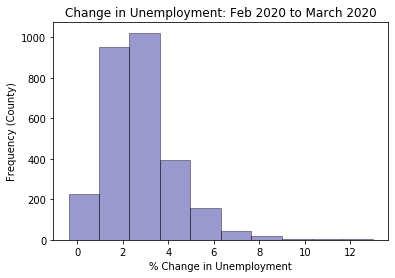

In [10]:
sns.distplot(df['yearly_change'], hist=True, kde=False, 
             bins=10, color = 'darkblue', 
              hist_kws={'edgecolor':'black'},
              kde_kws={'linewidth': 4})
plt.xlabel('% Change in Unemployment')
plt.ylabel('Frequency (County)')
plt.title('Change in Unemployment: Feb 2020 to March 2020')
plt.show

In [11]:
# Change to April
map_by_county('yearly_change', unemp_change_bins,
                title='% Change in Unemployment: April 2019 to April 2020',
                colorscale=DIVERGENT_RGB)

<function matplotlib.pyplot.show(*args, **kw)>

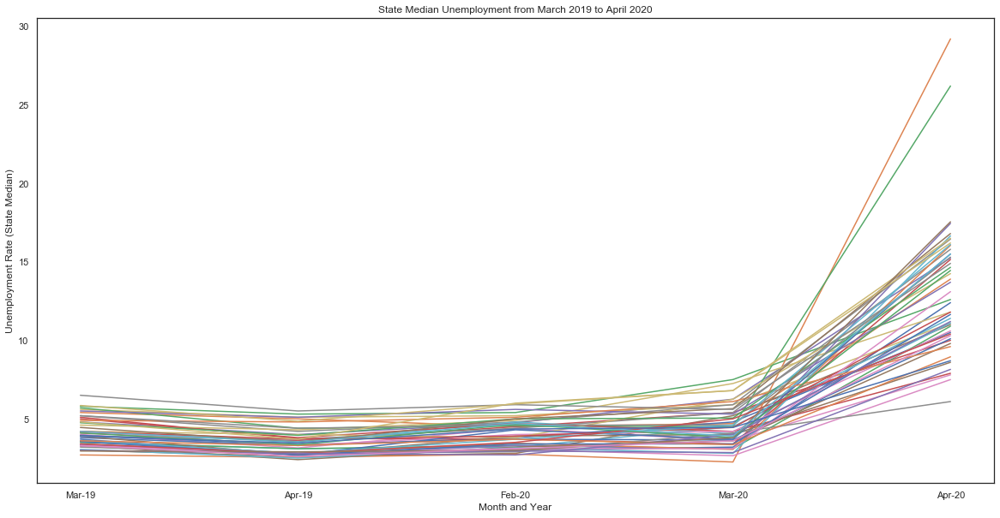

In [12]:
unemp = df[['Mar-19','Apr-19','Feb-20','Mar-20','Apr-20']].groupby(df['state_name']).agg('median').reset_index()
unemp = unemp.transpose()
new_header = unemp.iloc[0] #grab the first row for the header
unemp = unemp[1:] #take the data less the header row
unemp.columns = new_header

sns.set(rc={'figure.figsize':(20, 10)})
sns.set_style('white')
fig, ax = plt.subplots()
for state in unemp.columns:
    ax.plot(unemp.index, unemp[state], label=state)

plt.xlabel("Month and Year")
plt.ylabel("Unemployment Rate (State Median)")
plt.title("State Median Unemployment from March 2019 to April 2020")
plt.show

## COVID-19 Data

In [13]:
bins = df['covid_cases'].describe().tolist()[3:]
map_by_county('covid_cases', bins,
                title="Reported COVID Cases by County",
                colorscale=QUARTILE_RGB)

<function matplotlib.pyplot.show(*args, **kw)>

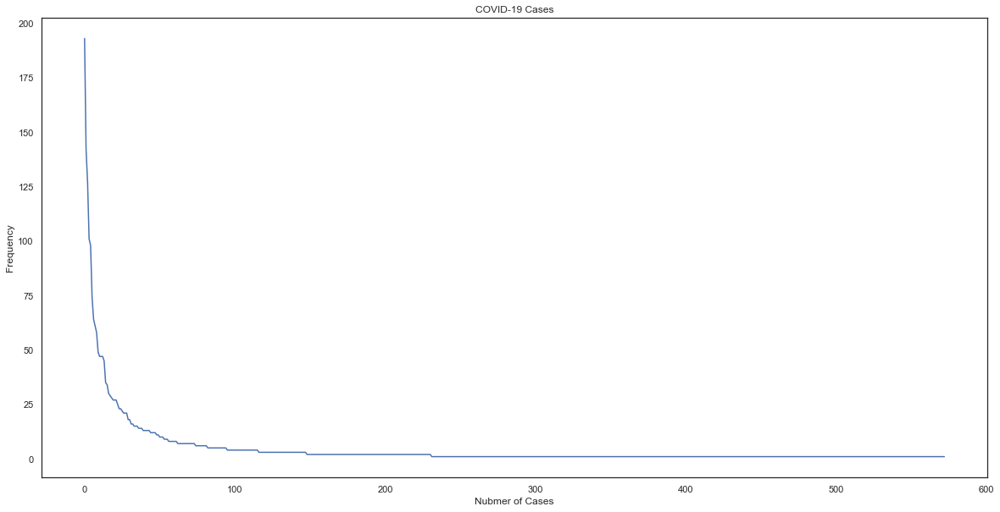

In [14]:
count_cases = df['covid_cases'].value_counts().sort_values(ascending=False).reset_index()
sns.lineplot(x=count_cases.index,y=count_cases['covid_cases'])
plt.title("COVID-19 Cases")
plt.xlabel("Nubmer of Cases")
plt.ylabel("Frequency")
plt.show

In [15]:
bins = df['Testing_Rate'].describe().tolist()[3:]
map_by_county('Testing_Rate', bins,
                title="Testing Rate (Reported at State Level)",
                colorscale=QUARTILE_RGB)

<function matplotlib.pyplot.show(*args, **kw)>

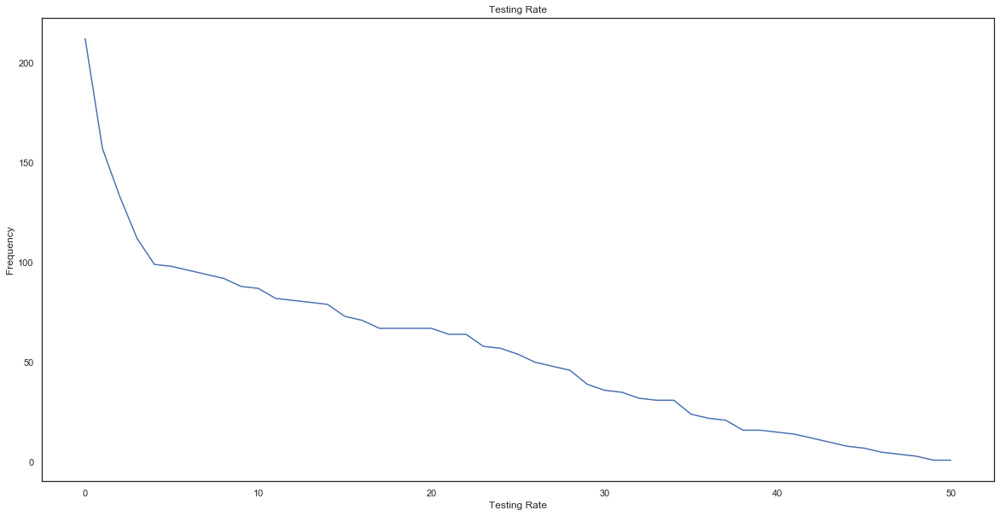

In [16]:
count_cases = df['Testing_Rate'].value_counts().sort_values(ascending=False).reset_index().reset_index()
sns.lineplot(x=count_cases.index,y=count_cases['Testing_Rate'])
plt.title("Testing Rate")
plt.xlabel("Testing Rate")
plt.ylabel("Frequency")
plt.show

In [17]:
bins = df['days_closed'].describe().tolist()[3:]
map_by_county('days_closed', bins,
                title="Number of Days Closed as of April 20",
                colorscale=QUARTILE_RGB)

<function matplotlib.pyplot.show(*args, **kw)>

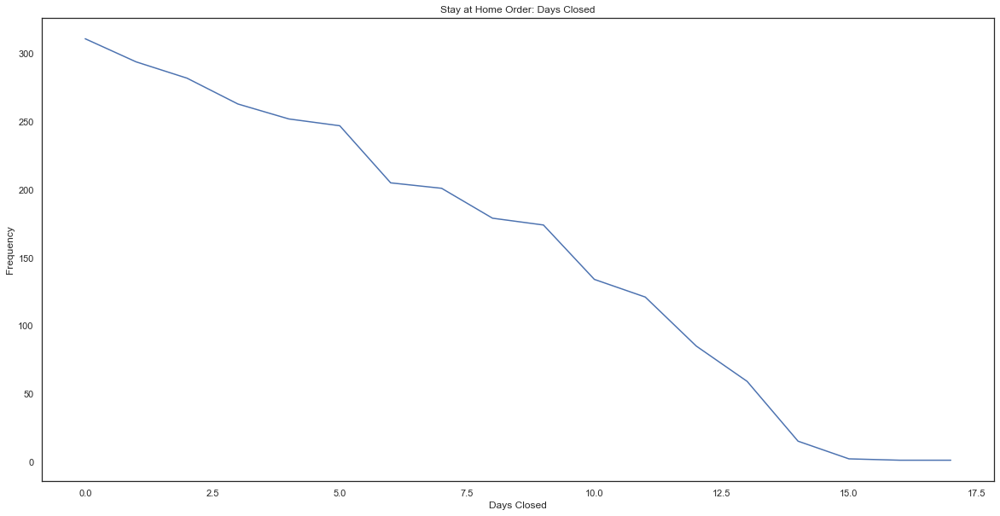

In [18]:
count_cases = df['days_closed'].value_counts().sort_values(ascending=False).reset_index()
sns.lineplot(x=count_cases.index,y=count_cases['days_closed'])
plt.title("Stay at Home Order: Days Closed")
plt.xlabel("Days Closed")
plt.ylabel("Frequency")
plt.show

## Unemployment vs. COVID-19 and Demographic Data

In [19]:
def trends(att):
    fig, (ax1,ax2) = plt.subplots(1,2)
    title = 'Unemployment variation by ' + att
    fig.suptitle(title)
    ax1.scatter(df[att],df['monthly_change'])
    ax1.set(xlabel=att, ylabel="% Change in Unemployment: February 2020 to March 2020")

    ax2.scatter(df[att], df['yearly_change'])
    ax2.set(xlabel=att, ylabel="% Change in Unemployment: March 2019 to March 2020")
    
    return fig

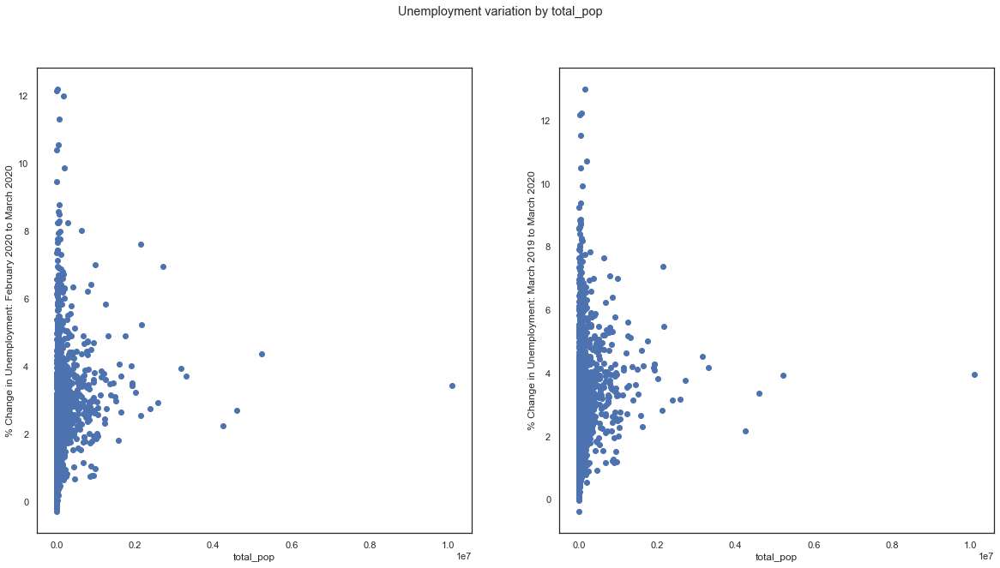

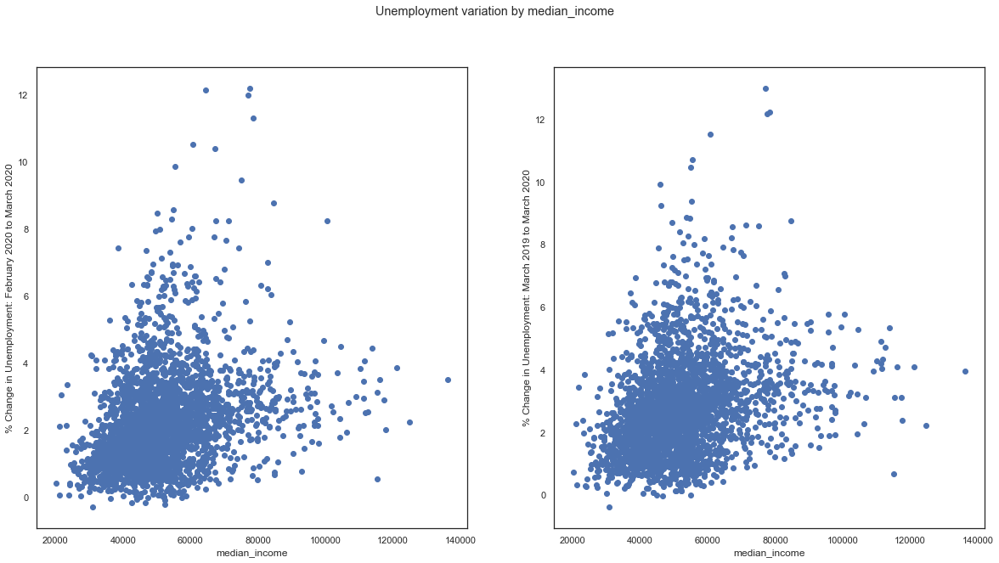

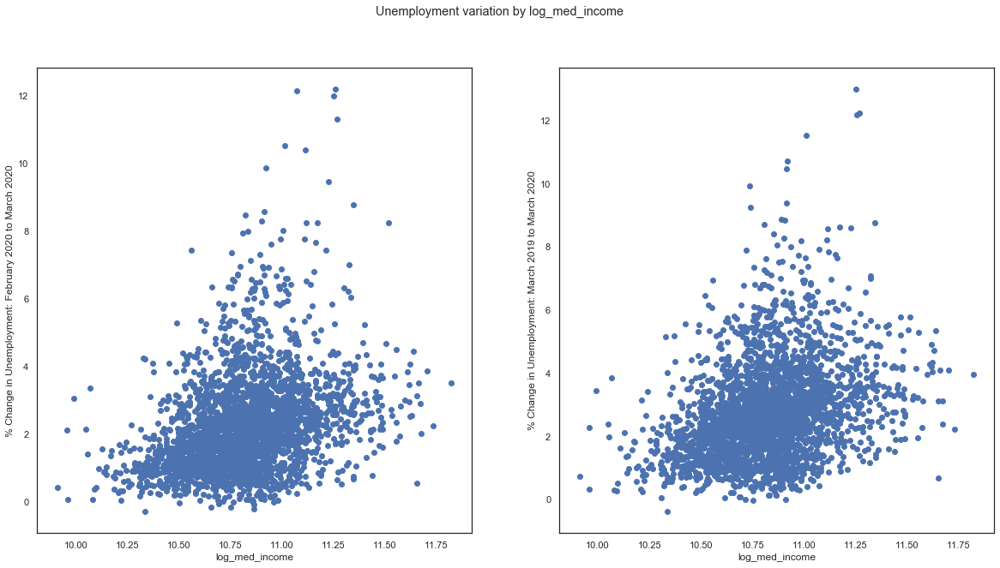

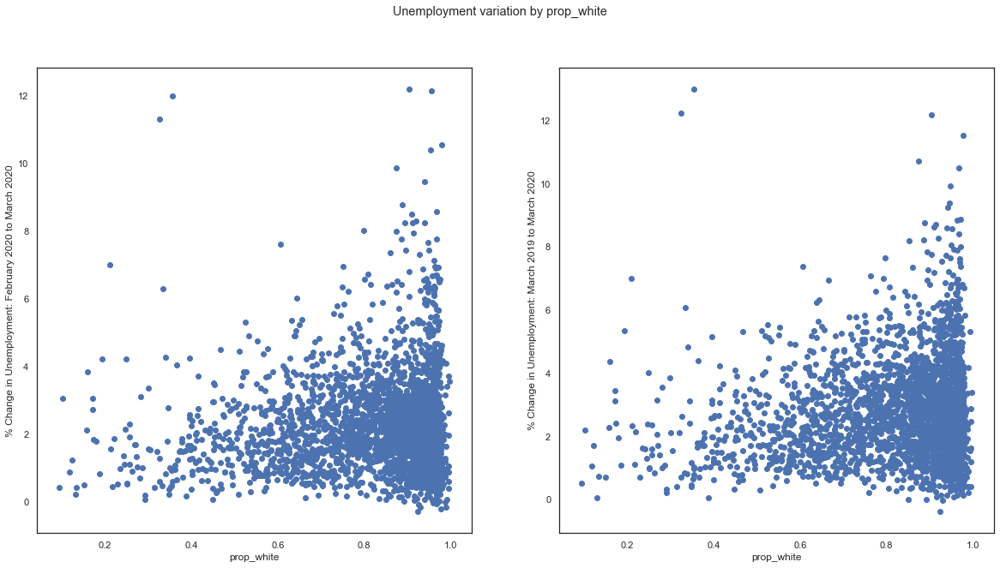

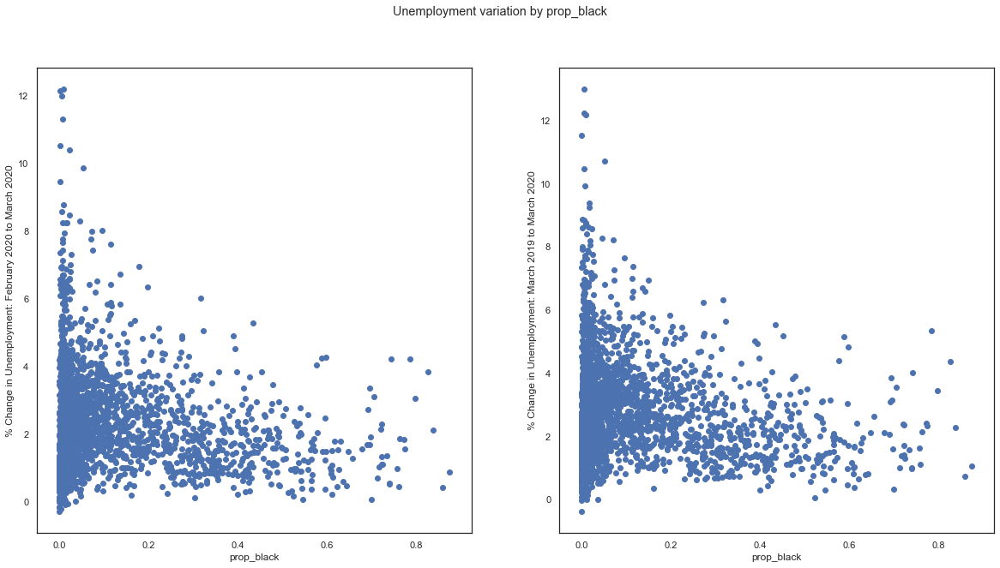

...

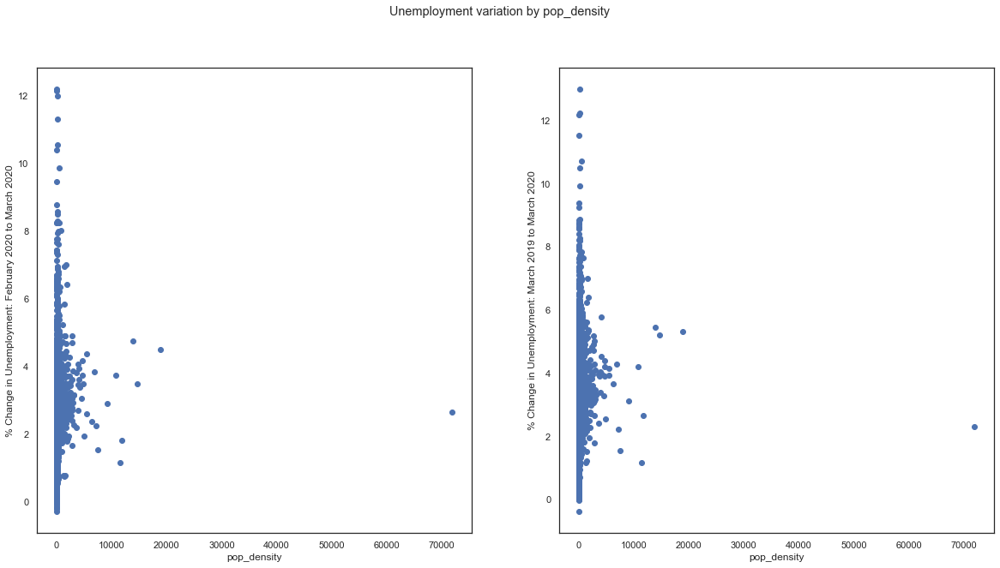

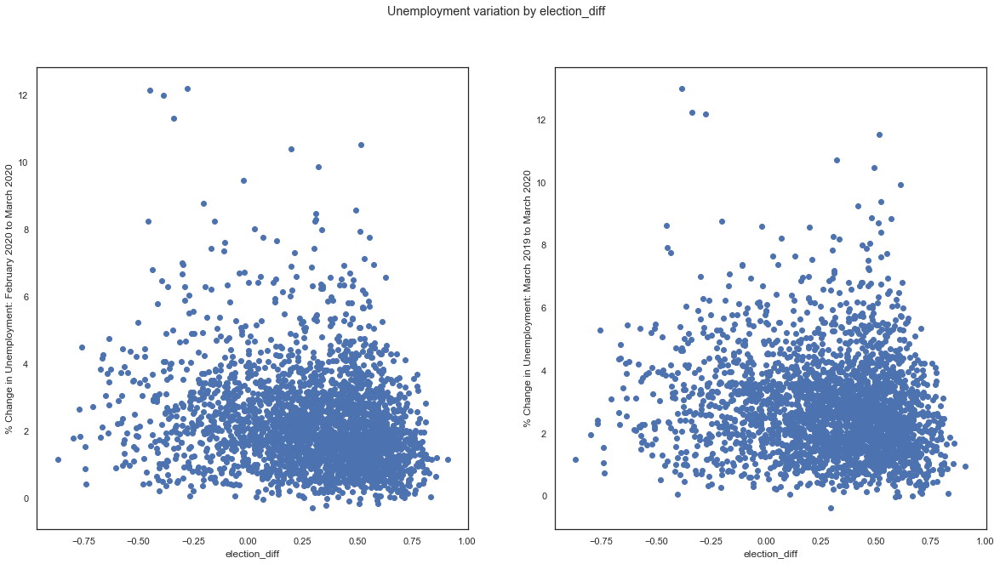

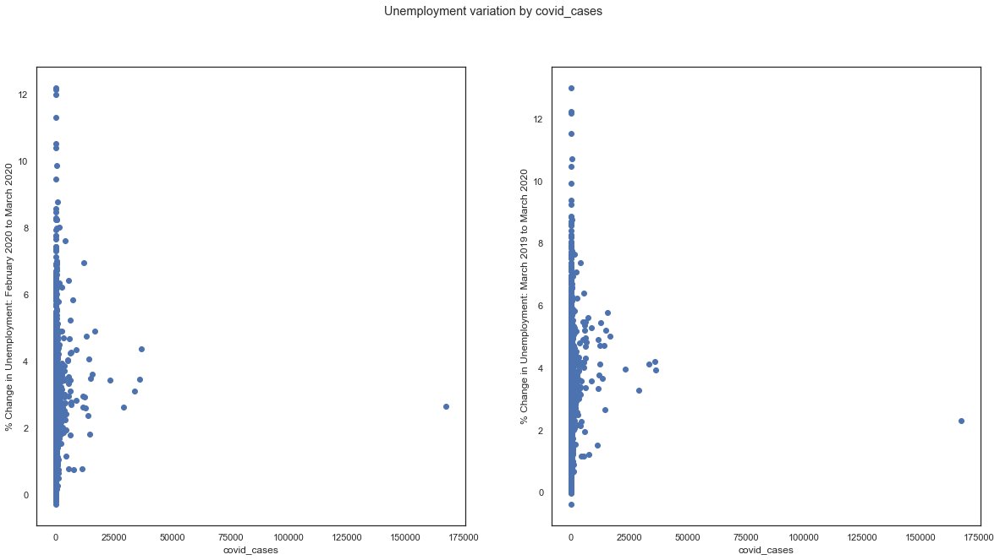

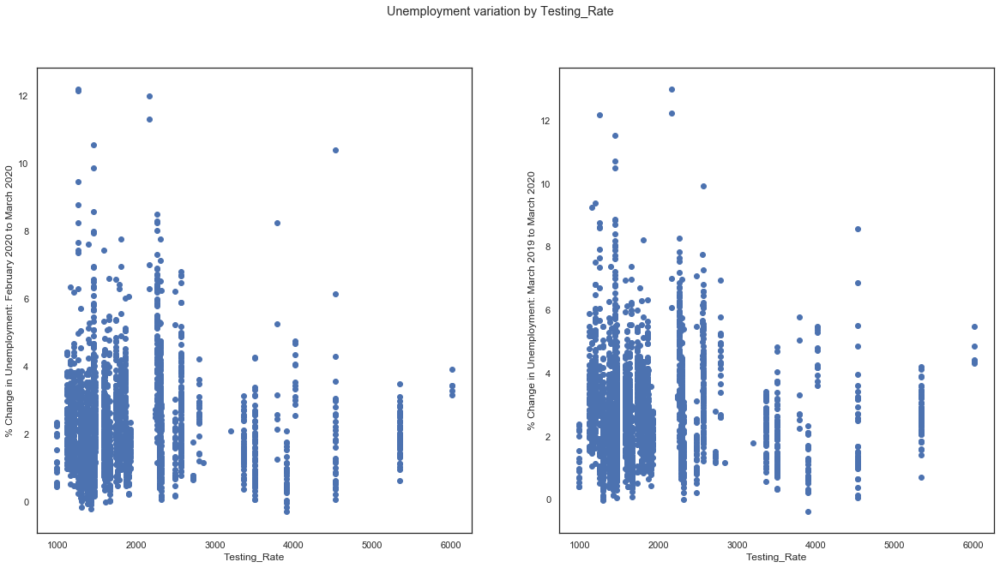

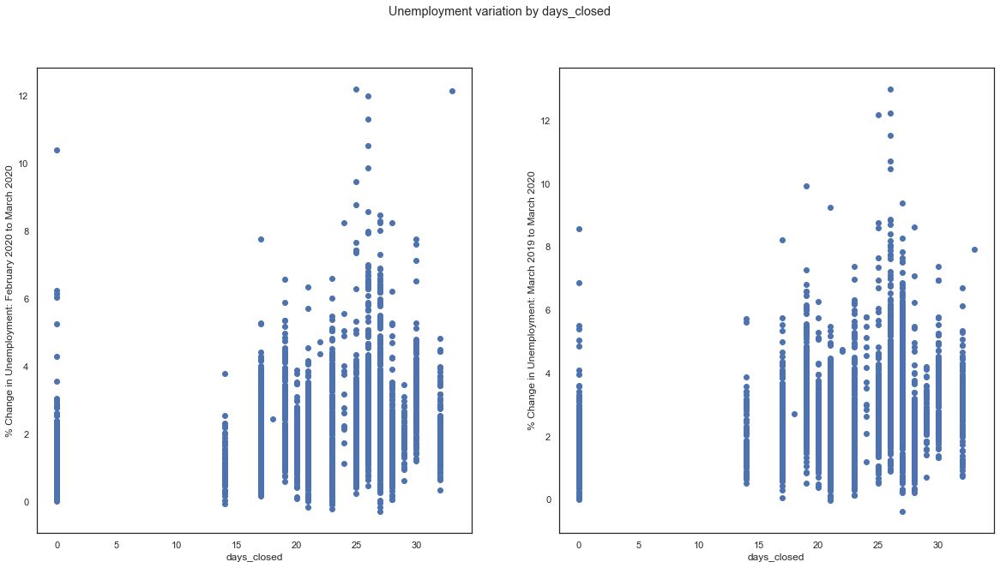

In [20]:
features = ['total_pop','median_income','log_med_income','prop_white', 'prop_black', 'prop_hisp', 'prop_no_internet', 'prop_ba',
        'prop_services', 'pop_density','election_diff','covid_cases','Testing_Rate','days_closed']

for feat in features:
    trends(feat)